# Variable renewable energy profile processing and plotting

__*python=3.6*__

> Author: [tilseb](tilseb@dtu.dk)
>
> Created: 2018-05-23
>
> Modified: 2019-12-09

## Content
- Import required packages
- Set global plot specification
- Read input files
- Format data frames
- Make directories
- Plot per commodity
- Plot per country

## Import Required Packages

In [2]:
# Imports
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

## Make Directories

In [3]:
# Make output folder
dirs = {'output/figs', 'output/data'}
for d in dirs:
    if not os.path.isdir(d):
        os.makedirs(d)

In [4]:
# Make spp folder
if not os.path.isdir('output/figs/pv_production'):
    os.makedirs('output/figs/pv_production')

In [5]:
# Make vwg folder
if not os.path.isdir('output/figs/wind_generation'):
    os.makedirs('output/figs/wind_generation')

## Set global plot specification

In [6]:
# Set plotting specifications
#% matplotlib inline
plt.rcParams.update({'font.size': 21})
plt.rcParams['xtick.major.pad']='12'
plt.rc('legend', fontsize=16)
y_limit = 1.1
lw = 3

## Read Input Files

In [7]:
# Read the solar power production from Data.xlsm
spp = pd.read_excel('input/Data.xlsm',
                    sheet_name='43', header=11, skipfooter=8793, index_col=0)

In [8]:
# Read the solar heat production from Data.xlsm
shp = pd.read_excel('input/Data.xlsm',
                    sheet_name='43', usecols='A:B', header=8801, skipfooter=3, index_col=0)

In [9]:
# Read the solar power production from Data.xlsm
spp_old = pd.read_excel('input/Data_old.xlsm',
                        sheet_name='43', header=11, skipfooter=8793, index_col=0)

In [10]:
# Read the variation of wind generation from Data.xlsm
vwg = pd.read_excel('input/Data.xlsm',
                    sheet_name='53', usecols='A:Y', header=13, skipfooter=21, index_col=0)

In [11]:
# Read the old variation of wind generation from Data_old.xlsm
vwg_old = pd.read_excel('input/Data_old.xlsm',
                        sheet_name='53', usecols='A:Y', header=13, skipfooter=10, index_col=0)

In [12]:
# Read the opsd variation of wind generation from Data_wind_opsd.csv
# Source: https://data.open-power-system-data.org/time_series/
vwg_opsd = pd.read_csv('input/Data_wind_opsd.csv', encoding='utf8', index_col=0, parse_dates=True)

# and the installed capacities
wcap_opsd = pd.read_csv('input/Data_wind_cap_opsd.csv', encoding='utf8')
wcap_opsd.index = vwg.index

## Format Data Frames

In [13]:
# Make a list of all considered ountries
#ccc = ['DK', 'DE', 'NO', 'SE']
ccc = ['DE']

### Solar Power Production

In [14]:
# Make columns for seasons and terms
spp['season'] = spp.index.str.split('.').str[0]
spp['term'] = spp.index.str.split('.').str[1]

In [15]:
# Divide each number of each countries columns by it's annual maximum 
for c in ccc:
    for i in spp[spp.columns[spp.columns.str.contains(c)==True]].columns:
        spp[i] /= spp[i].max()

In [16]:
# Make columns for seasons and terms
spp_old['season'] = spp_old.index.str.split('.').str[0]
spp_old['term'] = spp_old.index.str.split('.').str[1]

In [17]:
# Divide each number of each countries columns by it's annual maximum 
for c in ccc[:2]:
    for i in spp_old[spp_old.columns[spp_old.columns.str.contains(c)==True]].columns:
        spp_old[i] /= spp_old[i].max()

In [18]:
# Make columns with country average
spp_old['DK'] = spp_old[spp_old.columns[spp_old.columns.str.contains('DK')==True]].sum(axis=1)
spp_old['DE'] = spp_old[spp_old.columns[spp_old.columns.str.contains('DE')==True]].sum(axis=1)

In [19]:
# Divide each number by each countries annual maximum
for c in ccc[:2]:
    spp_old[c] /= spp_old[c].max()

### Solar HeatProduction

In [20]:
# Make columns for seasons and terms
shp['season'] = shp.index.str.split('.').str[0]
shp['term'] = shp.index.str.split('.').str[1]

In [21]:
# Divide each number of each countries columns by it's annual maximum 
shp.DK2_Large /= shp.DK2_Large.max()

### Variation of Wind Generation

In [22]:
# Make columns for seasons and terms
vwg['season'] = vwg.index.str.split('.').str[0]
vwg['term'] = vwg.index.str.split('.').str[1]

In [23]:
# Divide each row of each countries columns by its hourly percentage and annual maximum
# Values greater than 1 are reduced to 1
for c in ccc:
    for i in vwg[vwg.columns[vwg.columns.str.contains(c)==True]].columns:
        if 'Offshore' in i:
            vwg[i] = vwg[i] / wcap_opsd['DE_wind_offshore_capacity_annual_relative'] / vwg[i].max()
            vwg[i] = np.where(vwg[i] > 1, 1, vwg[i])
        else:
            vwg[i] = vwg[i] / wcap_opsd['DE_wind_capacity_annual_relative'] / vwg[i].max()
            vwg[i] = np.where(vwg[i] > 1, 1, vwg[i])

In [24]:
# Shift the DE4-N profile 5 terms back and fill the last fife in a forward manner
vwg['adjust'] = vwg['DE4-N_A'].shift(-5).ffill()

# Calculate the difference between DE4-N and DE4-W_Offshore
diff = vwg['DE4-N_A'] - vwg['DE4-W_Offshore_A']

# Make an index for all differences greater than zero
idx = diff[diff>0].index

# Subtract the mean of the positive differences from the shifted DE4-N profile, where it occours
for i in idx:
    vwg.loc[i, 'DE4-W_Offshore_A'] = vwg.loc[i, 'adjust'] - diff[diff>0].mean()

# Convert all negative numerical entries to zero
num = vwg._get_numeric_data()
num[num < 0] = 0

# DE4-N_Offshore is the same as DE4-W_Offshore
vwg['DE4-N_Offshore_A'] = vwg['DE4-W_Offshore_A']

# DE4-E_Offshore is the same as DE4-E_Offshore
vwg['DE4-E_Offshore_A'] = vwg['DE4-W_A']

In [25]:
# Round and write the resulting profiles to a csv file
output = vwg[['DE4-N_Offshore_A','DE4-W_Offshore_A']].round(3)
output.to_csv('output/data/DE4-Offshore_A.csv', encoding='utf8')

In [26]:
# Make columns for seasons and terms
vwg_old['season'] = vwg_old.index.str.split('.').str[0]
vwg_old['term'] = vwg_old.index.str.split('.').str[1]

In [27]:
# Divide each number of each countries columns by it's annual maximum 
for c in ccc:
    for i in vwg_old[vwg_old.columns[vwg_old.columns.str.contains(c)==True]].columns:
        vwg_old[i] /= vwg_old[i].max()

In [28]:
# Make columns with country sums
for c in ccc:
    vwg_old[c] = vwg_old[vwg_old.columns[vwg_old.columns.str.contains(c)==True]].sum(axis=1)

In [29]:
# Divide each number by each countries annual maximum
for c in ccc:
    vwg_old[c] /= vwg_old[c].max()

## Select Seasons

In [30]:
# Make a list of all seasons
sss = list(spp.season.unique())

In [31]:
# Seasons to investigate
# season_names = ['S01', 'S07', 'S20', 'S24', 'S28', 'S38', 'S42', 'S43']

In [32]:
# Make a list of every nth element of sss (1 <= nth <= 52)
nth = 1
s = sss[0::nth]

# Or select seasons by names
# s = season_names

## Select Terms

In [33]:
# Make a list of all Terms per season
ttt = list(spp.term.unique())

In [34]:
# Terms to investigate
# term_names = ['T005', 'T019', 'T033', 'T047', 'T061', 'T075', 'T089', 'T103', 'T117', 'T131', 'T145', 'T159']

In [35]:
# Make a list of every nth element of ttt (1 <= nth <= 168)
nth = 1
t = ttt[0::nth]

# Or select terms by name
# t = term_names

## Plotting

In [36]:
# Make data frames to plot
spp_plot = spp[(spp.season.isin(s)) & (spp.term.isin(t))]
shp_plot = shp[(shp.season.isin(s)) & (shp.term.isin(t))]
vwg_plot = vwg[(vwg.season.isin(s)) & (vwg.term.isin(t))]

In [37]:
# Set indices to terms
spp_plot.set_index('term', inplace=True)
shp_plot.set_index('term', inplace=True)
vwg_plot.set_index('term', inplace=True)

In [38]:
# Make data frames to plot
spp_old_plot = spp_old[(spp_old.season.isin(s)) & (spp_old.term.isin(t))]
vwg_old_plot = vwg_old[(vwg_old.season.isin(s)) & (vwg_old.term.isin(t))]

In [39]:
# Set indices to terms
spp_old_plot.set_index('term', inplace=True)
vwg_old_plot.set_index('term', inplace=True)

In [40]:
# Create vertical bars per step
steps = 24
t_selected = spp_plot.index.unique()[0::steps]
t_marker = np.arange(0, len(t), steps)

# Or mark selected terms
# t_selected = term_names
# t_marker = np.arange(0, len(t), steps)

## Save data to csv

In [41]:
spp_plot.to_csv('output/data/Data_spp_new.csv', encoding='utf8')

In [42]:
shp_plot.to_csv('output/data/Data_shp_new.csv', encoding='utf8')

In [43]:
vwg_plot.to_csv('output/data/Data_vwg_new.csv', encoding='utf8')

### Plot per Commodity 

#### Solar Power Production

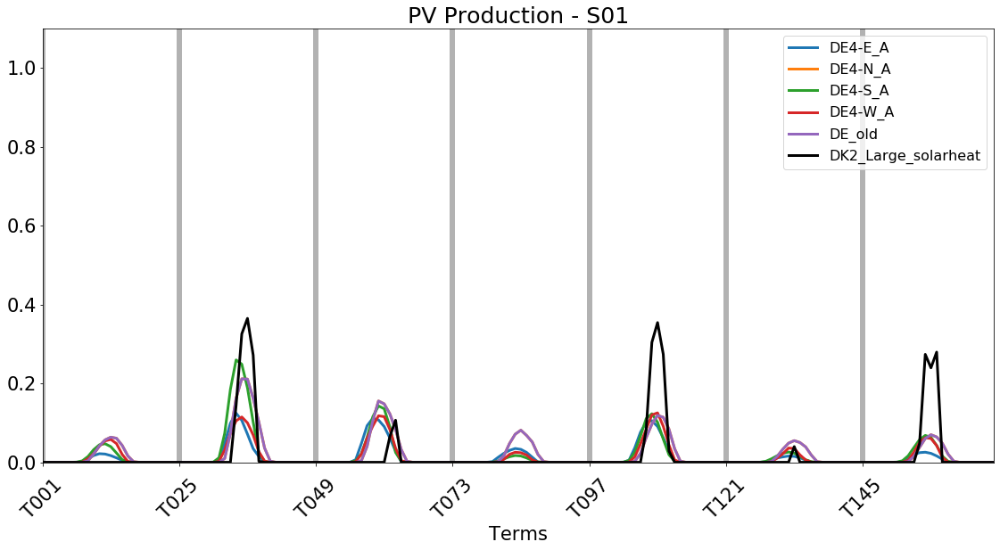

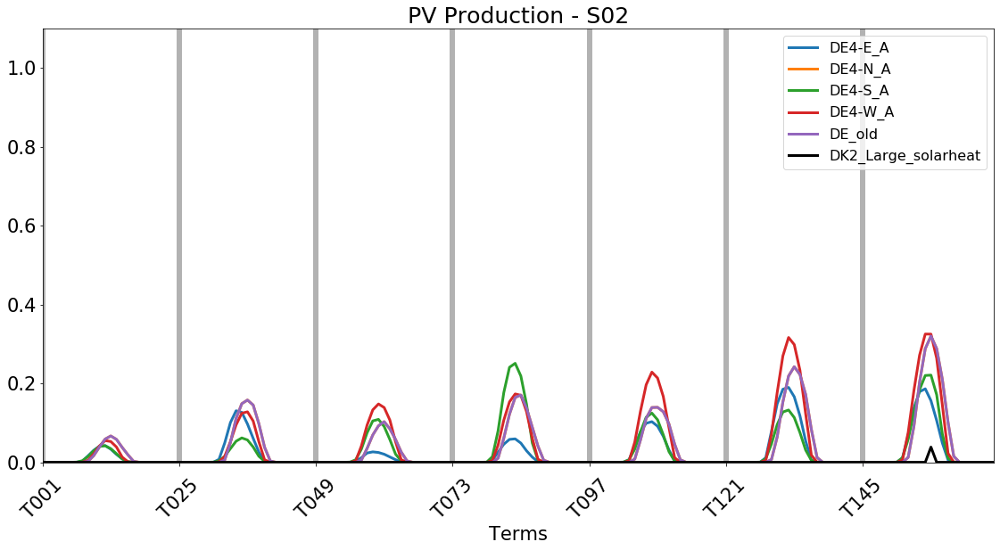

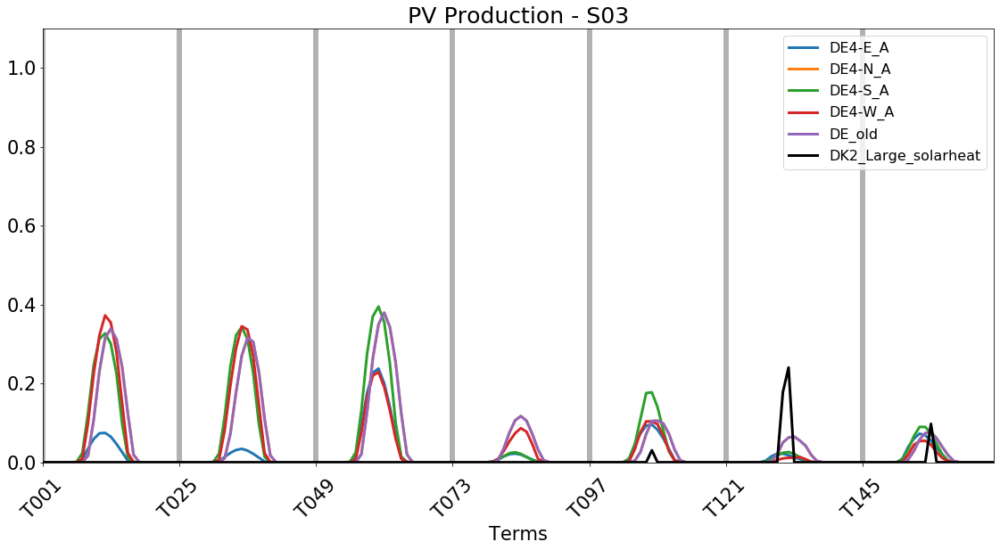

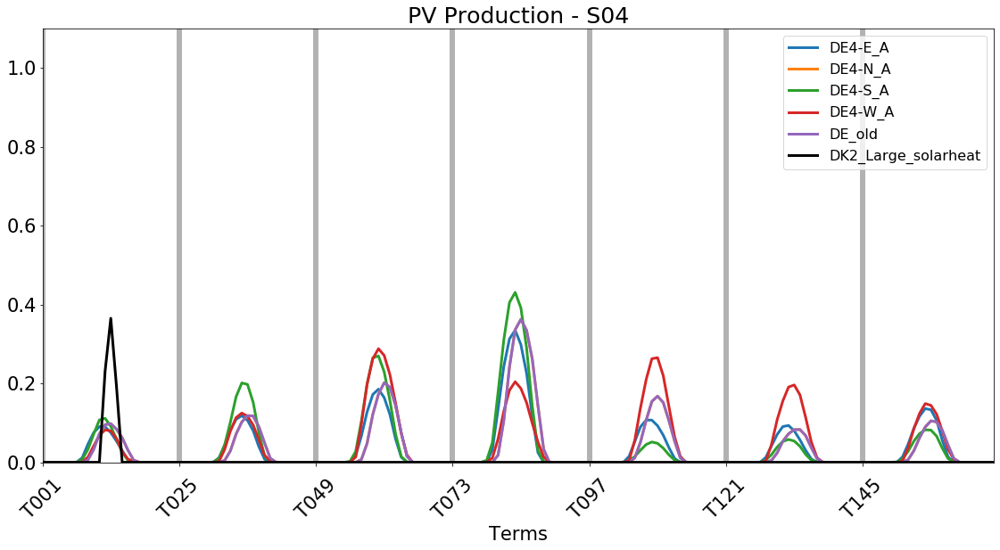

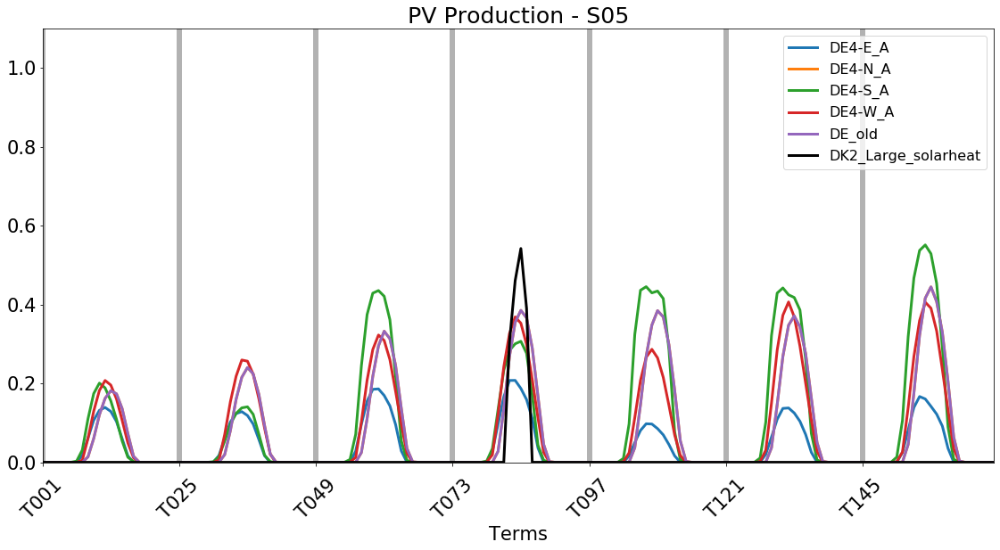

...

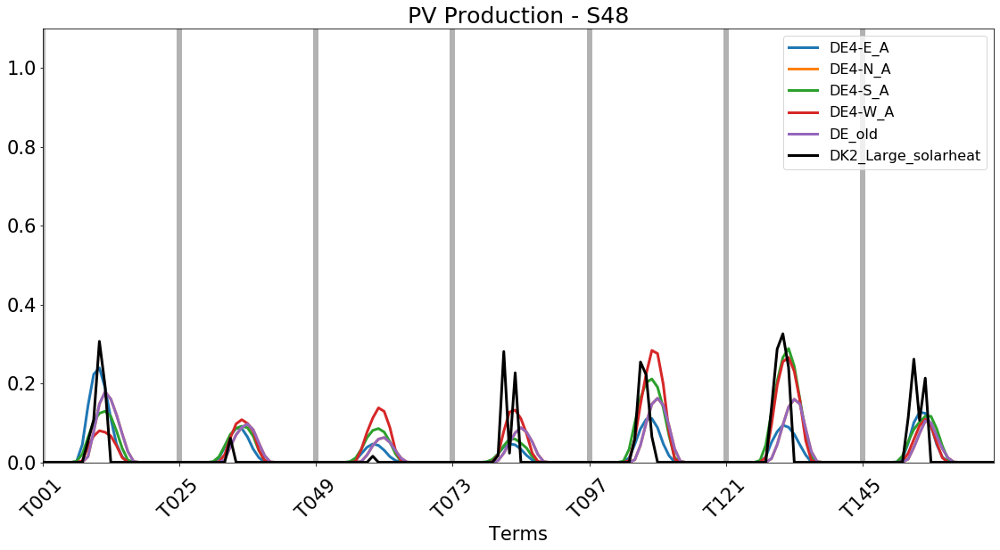

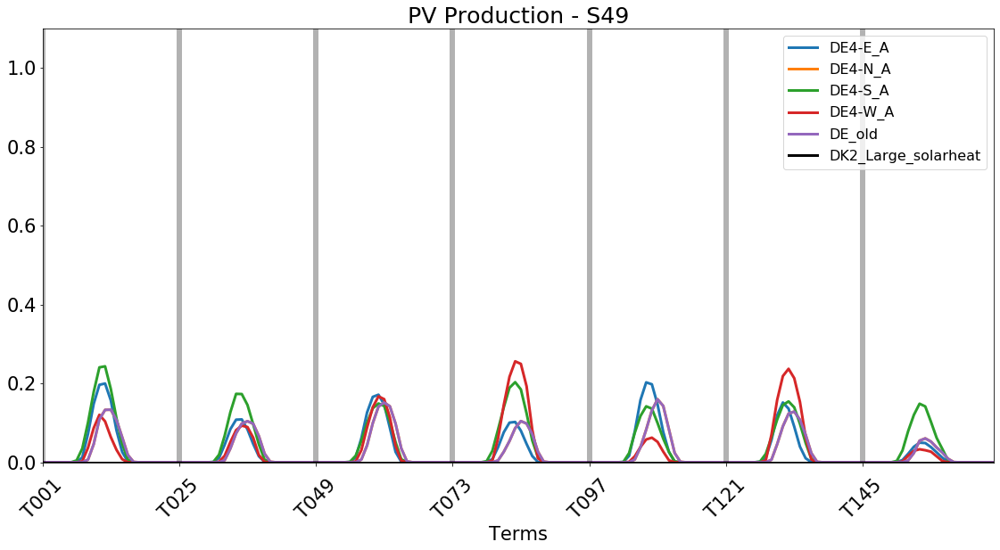

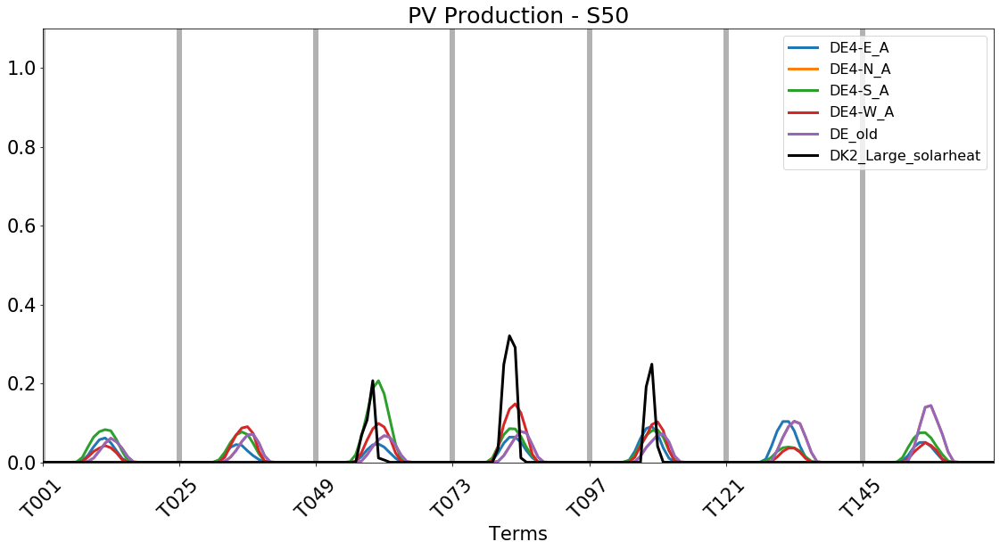

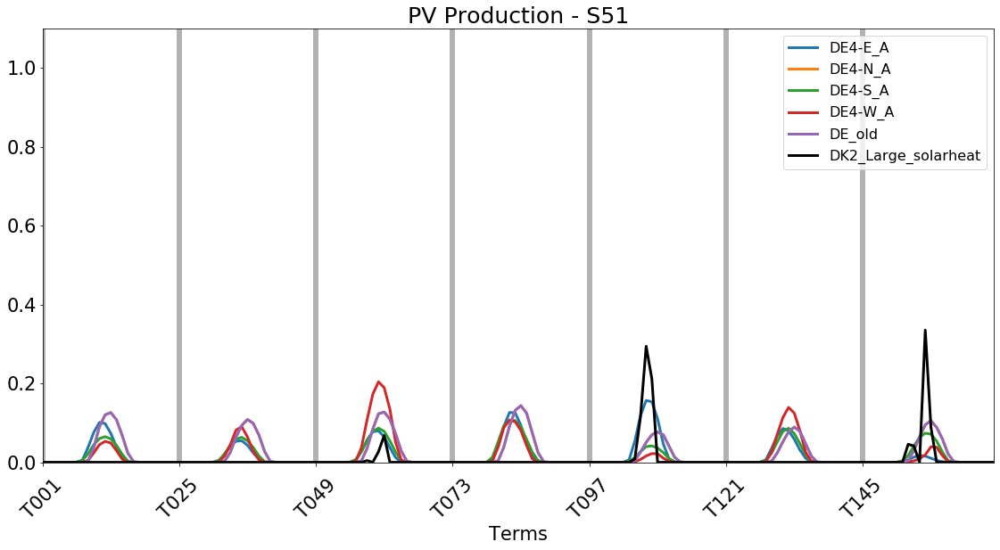

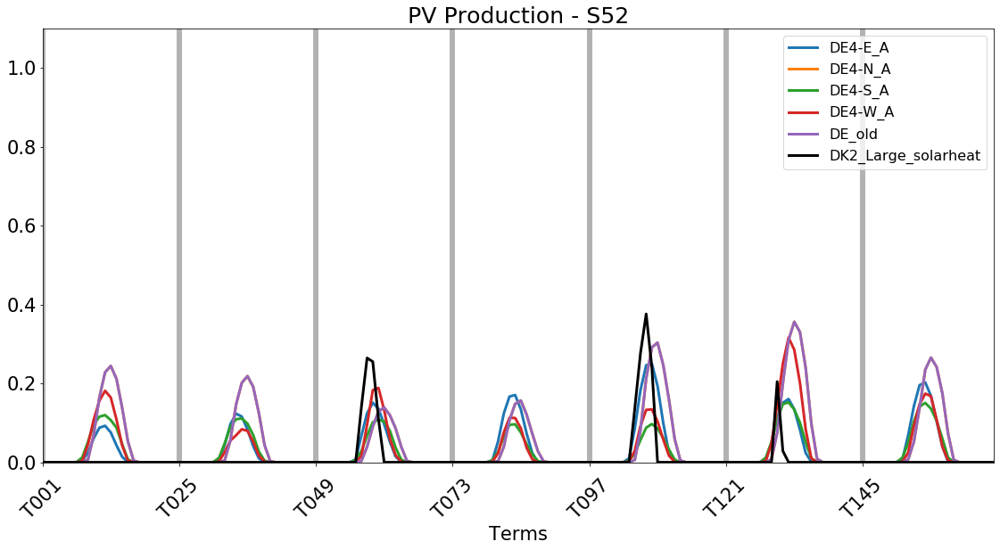

In [42]:
for i in s:
    x = spp_plot[spp_plot.season.isin([i])][spp_plot.columns[spp_plot.columns.str.contains(ccc[0])]].plot(figsize=(16,9), lw=lw)
    spp_old_plot[spp_old_plot.season.isin([i])]['DE'].plot(x=x, figsize=(16,9), lw=lw, label='DE_old')
    shp_plot[shp_plot.season.isin([i])]['DK2_Large'].plot(x=x, figsize=(16,9), lw=lw, c='black', label='DK2_Large_solarheat')
    plt.ylim([0, y_limit])
    plt.legend(loc=1)
    plt.title('PV Production' + ' - ' + i)
    plt.xlabel('Terms')
    plt.xticks(t_marker, t_selected, rotation=45)
    for x_pos in t_marker:
        plt.axvline(x=x_pos, c='black', lw=6, alpha=0.3)
    plt.tight_layout()
    plt.savefig('output/figs/pv_production/spp_' + i + '.png', compression=None)
    plt.show()
    plt.close()
plt.close()

#### Variation of Wind Generation

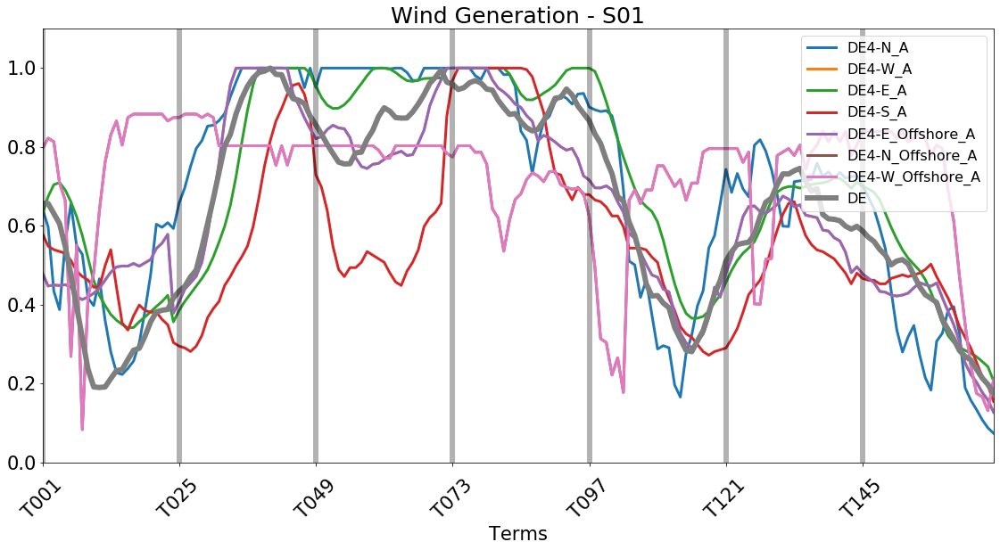

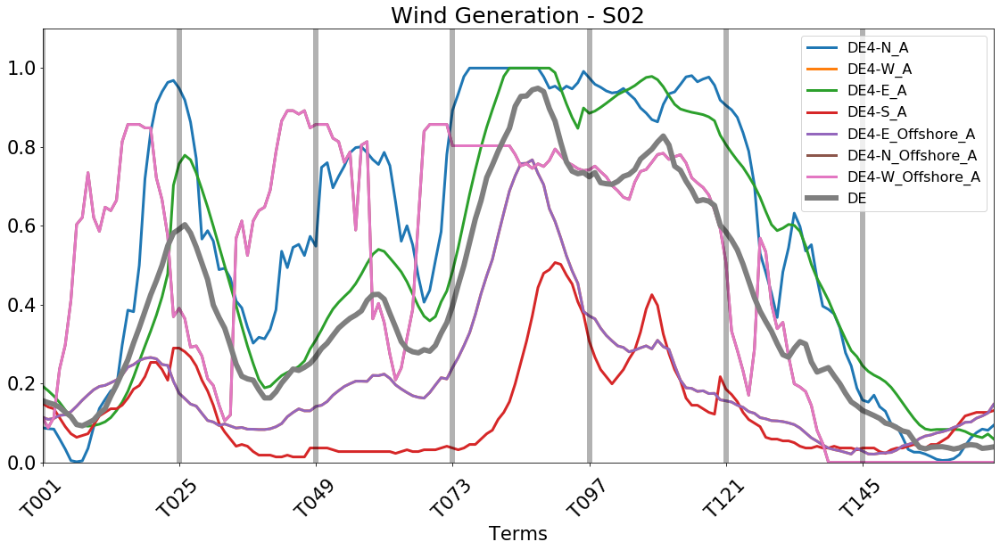

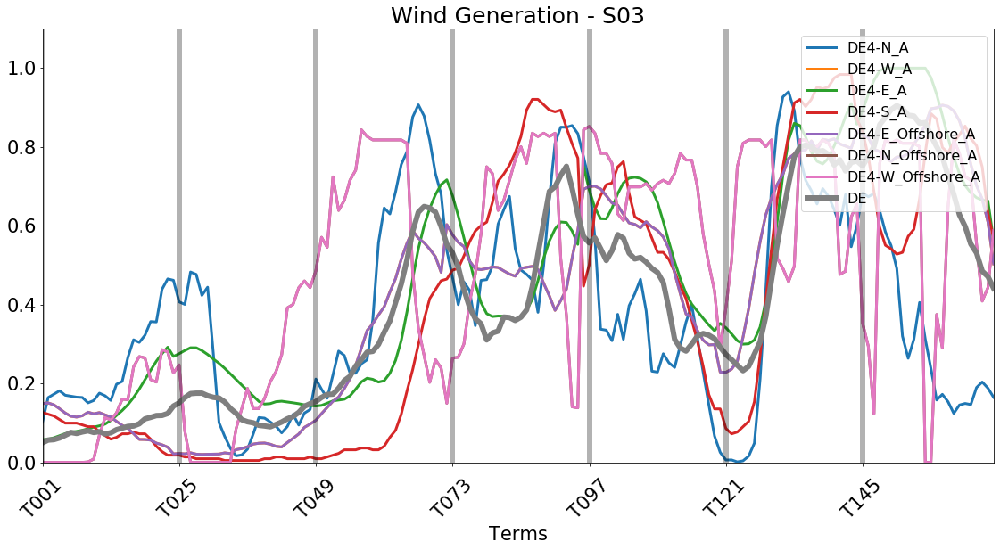

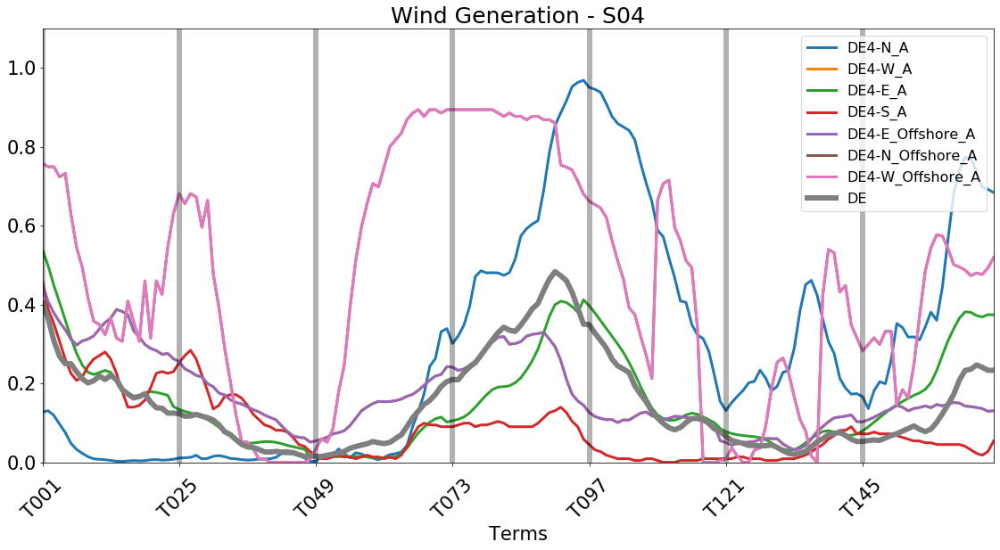

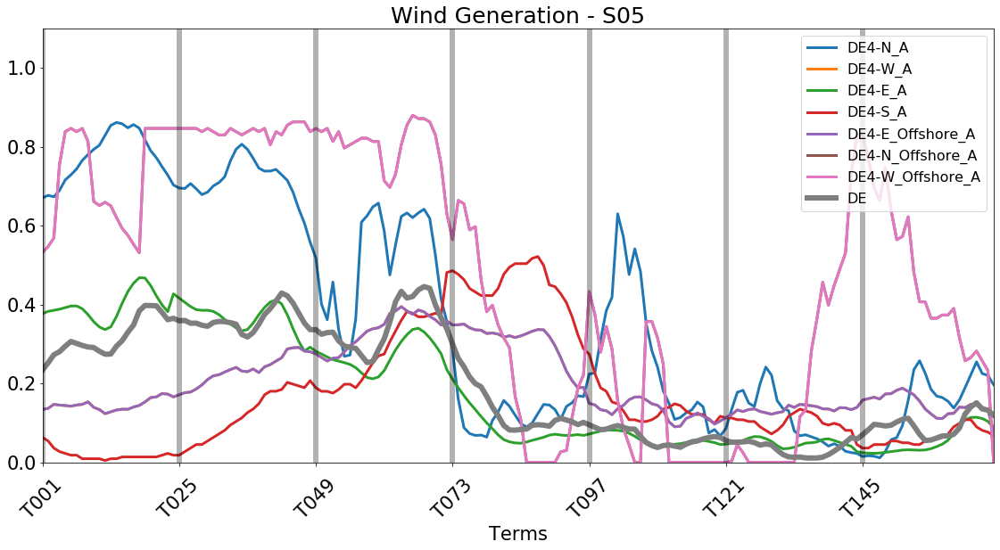

...

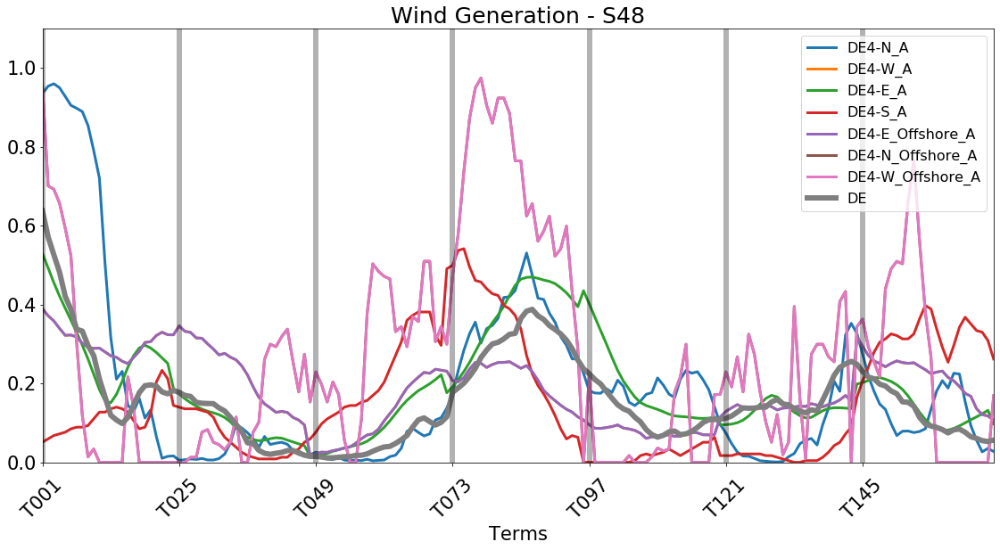

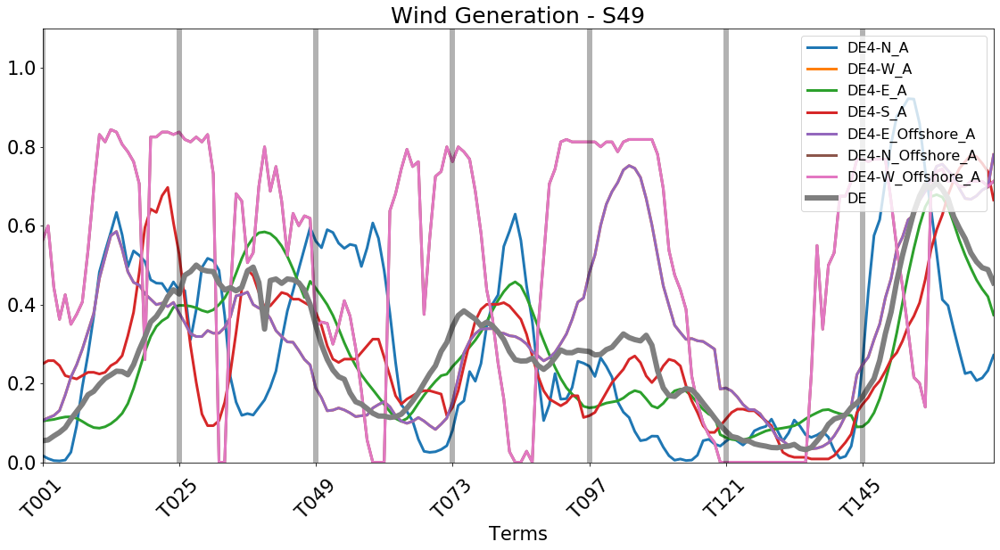

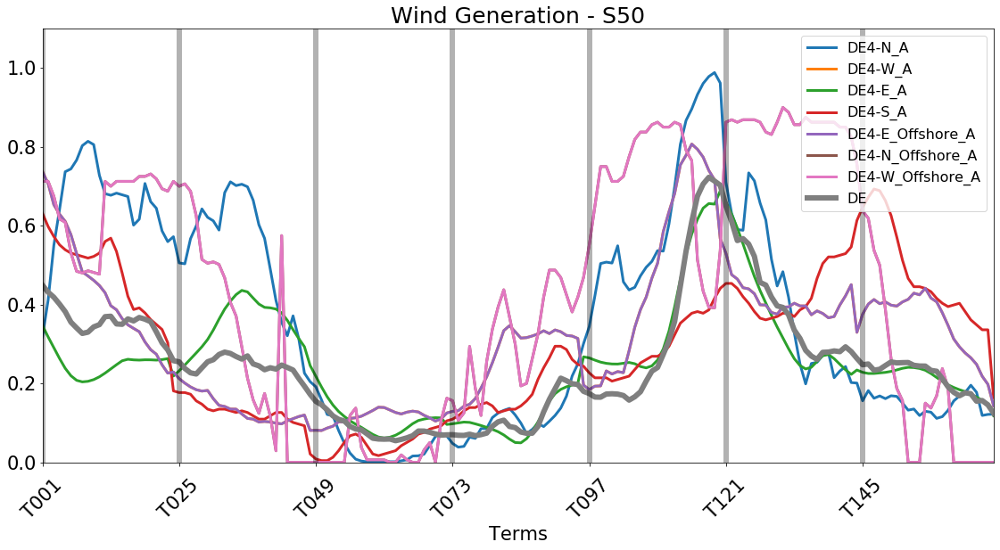

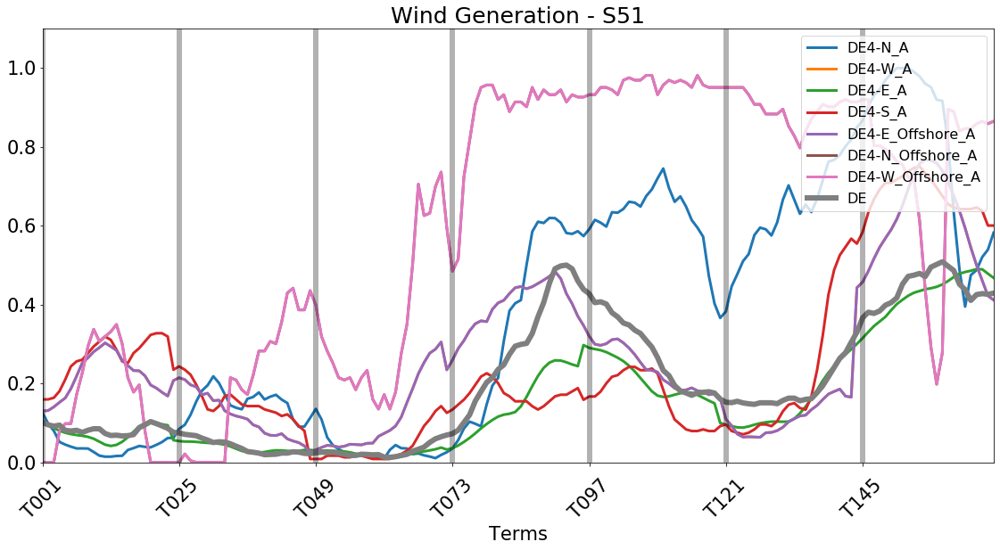

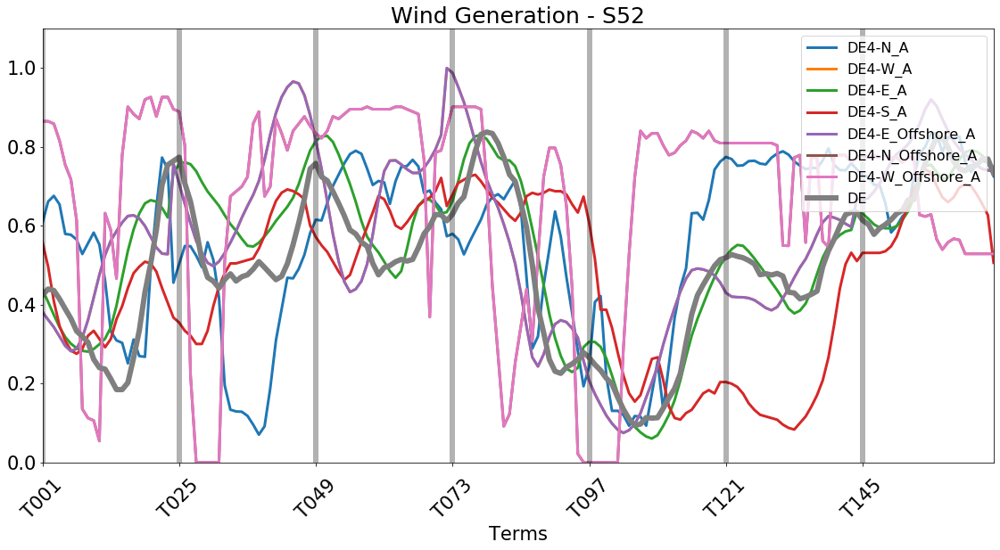

In [43]:
for i in s:
    x = vwg_plot[vwg_plot.season.isin([i])][vwg_plot.columns[vwg_plot.columns.str.contains(ccc[0])]].plot(figsize=(16,9), lw=lw)
    vwg_old_plot[vwg_old_plot.season.isin([i])]['DE'].plot(x=x, figsize=(16,9), lw=lw*2)
    plt.ylim([0, y_limit])
    plt.legend(loc=1)
    plt.title('Wind Generation' + ' - ' + i)
    plt.xlabel('Terms')
    plt.xticks(t_marker, t_selected, rotation=45)
    for x_pos in t_marker:
        plt.axvline(x=x_pos, c='black', lw=6, alpha=0.3)
    plt.tight_layout()
    plt.savefig('output/figs/wind_generation/vwg_' + i + '.png', compression=None)
    plt.show()
    plt.close()
plt.close()